# Package importing

In [1]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

import folium # map rendering library

print('Libraries imported.')

Libraries imported.


# Data downloading

In [3]:
df = pd.read_html('https://it.wikipedia.org/wiki/Quartieri_di_Napoli')[0]
df.rename(columns = {'Quartiere': 'Borough'}, inplace = True)
df.head()

,Borough,Circoscrizione(1980-2006),Municipalità(2006-oggi)
0,Arenella,Circoscrizione 11 Arenella,Municipalità 05
1,Avvocata,Circoscrizione 08 Avvocata - Montecalvario - S...,Municipalità 02
2,Bagnoli,Circoscrizione 01 Bagnoli,Municipalità 10
3,Barra,Circoscrizione 19 Barra,Municipalità 06
4,Chiaia,Circoscrizione 05 Chiaia - Posillipo - San Fer...,Municipalità 01


Download Latitude/Longitude using Geopy library.

In [4]:
geolocator = Nominatim(user_agent="na_explorer")
df['Latitude']=""
df['Longitude']=""
i=0
for borough in df['Borough']:
    location = geolocator.geocode(borough+", Napoli, IT")
    df.loc[i,'Latitude'] = location.latitude
    df.loc[i,'Longitude'] = location.longitude
    i+=1


Piscinola and Marianella are defined as two different borough but actually Marianella is a sub-borough of Piscinola.  
We will see later in population data thPiscinolaat these two borough are grouped, the same as per number of residents. Grouping them, we will maintain Piscinola name and coordinates.

In [5]:
df.loc[df['Borough'] == 'Piscinola','Borough'] = 'Piscinola'

In [6]:
df = df[df['Borough'] != 'Marianella']

In [51]:
df.sample(5)

,Borough,Circoscrizione(1980-2006),Municipalità(2006-oggi),Latitude,Longitude
12,Pianura,Circoscrizione 04 Pianura,Municipalità 09,40.8607,14.1713
16,Porto,Circoscrizione 08 Avvocata - Montecalvario - S...,Municipalità 02,40.8444,14.2554
29,Vomero,Circoscrizione 10 Vomero,Municipalità 05,40.8438,14.2255
1,Avvocata,Circoscrizione 08 Avvocata - Montecalvario - S...,Municipalità 02,40.8521,14.2427
0,Arenella,Circoscrizione 11 Arenella,Municipalità 05,40.8537,14.2253


Downloading from wikipedia page population data for each borough. Then a little bit of data manipulation.

In [129]:
row_density = pd.read_html("https://it.wikipedia.org/wiki/Municipalit%C3%A0_di_Napoli")


df_density = row_density[1]

for i in range(2,11):
    df_density = df_density.append(row_density[i])


df_density.columns = ['Borough','Population', 'Area']
df_density=df_density[df_density['Borough']!='TOTALE']
df_density.sort_values('Borough',inplace=True)
df_density.reset_index(drop=True, inplace=True)
df_density.loc[df_density['Borough'] == 'Piscinola-Marianella', 'Borough'] = 'Piscinola'

In [130]:
df_density.head()

,Borough,Population,Area
0,Arenella,72.031 residenti,"Superficie pari a 5,25 km²"
1,Avvocata,43.002 residenti,"Superficie pari a 1,22 km²"
2,Bagnoli,24.671 residenti,"Superficie pari a 7,96 km²"
3,Barra,38.183 residenti,"Superficie pari a 7,82 km²"
4,Chiaia,41.423 residenti,"Superficie pari a 2,71 km²"


Lets manipulate Population and Area column in order to get numbers instead that strings.

In [131]:
tmp = df_density['Population'].str.replace(" residenti", "")
tmp = tmp.str.split('.')

for j in range(len(df_density['Population'])):
        tmp1 = tmp[j][0]+tmp[j][1]
        df_density['Population'][j] = int(tmp1)

In [150]:
df_density['Area'] = df_density['Area'].str.replace("Superficie pari a ", "").str.replace("\xa0km²", "").str.replace(',','.').astype(float)


In [153]:
df_density.rename(columns = {'Area':'Area (kmq)'}, inplace=True)

In [154]:
df_density.head()

,Borough,Population,Area (kmq)
0,Arenella,72031,5.25
1,Avvocata,43002,1.22
2,Bagnoli,24671,7.96
3,Barra,38183,7.82
4,Chiaia,41423,2.71


In [155]:
df_density['Pop/kmq'] = df_density['Population']/df_density['Area (kmq)']

In [159]:
df_density.sort_values('Pop/kmq',ascending = False).reset_index(drop=True).head()

,Borough,Population,Area (kmq),Pop/kmq
0,Avvocata,43002,1.22,35247.5
1,San Lorenzo,49275,1.42,34700.7
2,Montecalvario,25167,0.75,33556
3,Pendino,15625,0.63,24801.6
4,Mercato,9617,0.39,24659


Here is it. Lets check if the two dataframes have equals number of borough.

In [11]:
print("Population dataframe has {} boroughs.".format(len(df)))

Population dataframe has 30 boroughs.


In [12]:
print("Coordinates dataframe has {} boroughs.".format(len(df_density)))

Coordinates dataframe has 30 boroughs.


Ok, now we are going to merge the two dataframes, joining them on Borough column.

In [13]:
df_merge = df.merge(df_density, on='Borough', how = 'left')


In [14]:
df_merge.head()

,Borough,Circoscrizione(1980-2006),Municipalità(2006-oggi),Latitude,Longitude,Population,Area
0,Arenella,Circoscrizione 11 Arenella,Municipalità 05,40.8537,14.2253,72031,"Superficie pari a 5,25 km²"
1,Avvocata,Circoscrizione 08 Avvocata - Montecalvario - S...,Municipalità 02,40.8521,14.2427,43002,"Superficie pari a 1,22 km²"
2,Bagnoli,Circoscrizione 01 Bagnoli,Municipalità 10,40.8151,14.1668,24671,"Superficie pari a 7,96 km²"
3,Barra,Circoscrizione 19 Barra,Municipalità 06,40.84,14.3199,38183,"Superficie pari a 7,82 km²"
4,Chiaia,Circoscrizione 05 Chiaia - Posillipo - San Fer...,Municipalità 01,40.8353,14.2283,41423,"Superficie pari a 2,71 km²"


Now we are going to download from the official website of Naples townhall the data of borough's boundaries.  
We will use `requests`, `zipfile` and `io` library for downloading and unzipping the file. Then we will import geopandas library for mapping local coordinates in global one.


In [15]:
import requests, zipfile, io
r = requests.get("http://www.comune.napoli.it/flex/cm/pages/ServeAttachment.php/L/IT/D/8%252Fa%252Fe%252FD.8fbafa14e575ac594a1c/P/BLOB%3AID%3D26532/E/zip")
z = zipfile.ZipFile(io.BytesIO(r.content))
z.extractall('./Boundaries')

In [16]:
import geopandas as gpd

points_path = r"./Boundaries/quartieri2001.shp"
points_shape_map = gpd.read_file(points_path)
points_shape_map.to_crs(epsg=4326, inplace=True)


Lets now get Naples coordinate and plot a choroplet map using `folium` library.

In [17]:
address = 'Napoli, IT'

location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Naples are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Naples are 40.8359336, 14.2487826.


In [915]:
map_napoli = folium.Map(location=[latitude, longitude], zoom_start=12)
threshold_scale = np.linspace(df_merge['Population'].min(),
                              df_merge['Population'].max(),
                              6, dtype=int)
threshold_scale = threshold_scale.tolist() # change the numpy array to a list
threshold_scale[-1] = threshold_scale[-1] + 1 # make sure that the last value of the list is greater than the maximum immigration

map_napoli.choropleth(
    geo_data=points_shape_map.to_json(),
    data=df_merge,
    columns=['Borough','Population'],
    key_on='feature.properties.QUART',
    fill_color='YlGn', 
    threshold_scale=threshold_scale,
    fill_opacity=0.7, 
    line_opacity=0.7,
    legend_name='Population in Naples City',
    
)

# display map
display(map_napoli)

/home/lucar/anaconda3/lib/python3.7/site-packages/folium/folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


Lets upload Foursquare API, that we have stored in credentials.txt file (in the same folder of the notebook).

In [22]:
credentials = open("../credentials.txt","r").read().splitlines()

CLIENT_ID = credentials[0]
CLIENT_SECRET = credentials[1]

In [23]:
VERSION = '20200508'
LIMIT = 100

Lets define a function that will take latitude and longitude as parameters and will give back nearby venues within a given distance (radius).

In [24]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        #print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        try:
            results = requests.get(url).json()["response"]['groups'][0]['items']
        
            # return only relevant information for each nearby venue
            venues_list.append([( 
                v['venue']['name'],
                v['venue']['id'],
                v['venue']['location']['lat'], 
                v['venue']['location']['lng'],
                v['venue']['categories'][0]['name']) for v in results])
        except:
            pass

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = [ 
                  'Venue', 
                  'Venue ID',
                  'Venue Latitude', 
                  'Venue Longitude',
                  'Venue Category']
    
    return(nearby_venues)

Since Foursquare allows to retrieve 100 venues each call, we need to sample different points from the Napoli's boroughs. We will use `shapely` library for sample many coordinates that we will use as parameter for API call (see [here](https://gis.stackexchange.com/questions/207731/generating-random-coordinates-in-multipolygon-in-python) for other details on the below function).

In [25]:
import random
from shapely.geometry import Point

def generate_random(number, polygon):
    list_of_points = []
    minx, miny, maxx, maxy = polygon.bounds
    counter = 0
    while counter < number:
        pnt = Point(random.uniform(minx, maxx), random.uniform(miny, maxy))
        if polygon.contains(pnt):
            list_of_points.append(pnt)
            counter += 1
    return list_of_points

In [26]:
list_of_points_all = []
num_of_samples = 20
for j, borough in enumerate(points_shape_map['QUART']):
    tmp = generate_random(num_of_samples,points_shape_map.loc[points_shape_map['QUART']==borough,'geometry'][j])
    list_of_points_all.append([(
        borough, 
        point.y,
        point.x) for point in tmp])
    df_all_points = pd.DataFrame([item for points in list_of_points_all for item in points], columns = ['Borough','Latitude','Longitude'])
    df_all_points

Lets see 5 different samples.

In [52]:
df_all_points.shape

(600, 3)

In [53]:
df_all_points.sample(5)

,Borough,Latitude,Longitude
160,Piscinola,40.882871,14.243250
214,Ponticelli,40.852026,14.335430
134,Montecalvario,40.840687,14.243610
389,Vomero,40.845936,14.220452
186,Poggioreale,40.860182,14.280394


This is what we were looking for. Lets now call the API for getting venues in the different boroughs.

In [ ]:
napoli_venues = getNearbyVenues(names=df_all_points['Borough'],
                                latitudes=df_all_points['Latitude'],
                                longitudes=df_all_points['Longitude'],
                               radius = 500)

In [161]:
# Lets save data for future uses
#napoli_venues.to_csv('Data/napoli_venues.csv', index = False)
napoli_venues = pd.read_csv('Data/napoli_venues.csv')

In [162]:
napoli_venues.shape

(9600, 5)

In [163]:
napoli_venues.sample(5)

,Venue,Venue ID,Venue Latitude,Venue Longitude,Venue Category
7879,Piazza del Plebiscito,4bac9bf5f964a52006fe3ae3,40.836499,14.248937,Plaza
8377,Vyta Boulangerie Italiana,4f33eb540cd60690b74b63b0,40.852272,14.271961,Café
5364,Tandem d'asporti,56311c4f498e3bc732914e93,40.846409,14.256006,Sandwich Place
9031,Hostel of the Sun,4b9de636f964a52002c236e3,40.840331,14.255189,Hostel
4066,Olio&Pomodoro,52a8b9df11d26e6df1c56cd5,40.841499,14.217831,Pizza Place


In [164]:
napoli_venues['Venue ID'].value_counts().head()

4d8366e440a7a35d45eaf4bd    32
4e88b0c77beb54dc103a4807    32
56b25749498e28dddb5a071f    32
4c189c0e1436a593538a8d75    31
5463420f498e6bb7cee8039c    31
Name: Venue ID, dtype: int64

Since there can be overlapping searching area, it could results in duplicates in dataframe. Lets check by venue ID.

In [165]:
sum(napoli_venues['Venue ID'].value_counts()>1)

1170

So, there are many venues that have duplicates. Lets drop duplicates from dataframe and then lets assign each venue to its borough (based on boundaries coordinates). Here an example with 1 venue:

In [166]:
from shapely.geometry.polygon import Polygon

sample = napoli_venues.sample(2)
sample.reset_index(drop=True,inplace=True)
point = Point(sample.loc[1,'Venue Longitude'],sample.loc[1,'Venue Latitude'])

cond = pd.DataFrame(points_shape_map['geometry'].contains(point))
index = cond.index[cond[0]].to_list()[0]

try:
    print('The venue "'+sample['Venue'].values[0]+'" is in '+points_shape_map.loc[index,'QUART']+' borough.')
except:    
    print('The venue "'+sample['Venue'].values[0]+'" is outside the boroughs of the city of Napoli.')


    

The venue "Hotel Garibaldi" is in San Lorenzo borough.


Lets generate now a function to apply to the entire dataframe.

In [167]:
def inout(dataframe, dataframe_poly):
        
    # initialize empty column for Borough 
    tmp = dataframe.copy()
    tmp['Borough']=np.nan
    
    # lets loop on every venue in the dataframe
    for j, lat, lng in zip(range(len(dataframe)),dataframe['Venue Longitude'],dataframe['Venue Latitude']):
        point = Point(lat, lng)
        cond = pd.DataFrame(dataframe_poly['geometry'].contains(point))
        
        # get index where is true
        try:
            index = cond.index[cond[0]].to_list()[0]
            tmp.loc[j,'Borough'] = dataframe_poly.loc[index,'QUART']
        except:
            # if there is no index means that the venue is outside the boundaries of every borough,
            # and so outside the city of naples
            tmp.loc[j,'Borough'] = 'Outside'
        
    return(tmp)
    

We now remove duplicates and apply function above defined.

In [168]:
napoli_venues.drop_duplicates(inplace=True)
print("There are "+ str(sum(napoli_venues['Venue ID'].value_counts()>1))+" duplicates")

There are 0 duplicates


In [169]:
napoli_venues.reset_index(drop=True,inplace=True)
napoli_venues.head()

,Venue,Venue ID,Venue Latitude,Venue Longitude,Venue Category
0,PAN | Palazzo delle Arti Napoli,4bc37936920eb713e2811d2c,40.836403,14.236898,Art Museum
1,Frozen - Yogurt & Gelati,4e3975d6d22dea80c5307e39,40.836655,14.235203,Frozen Yogurt Shop
2,Piazza Amedeo,4cfbfbeaa9042c0f1723e20a,40.837217,14.233725,Plaza
3,Leopoldo Infante S.r.l.,4ed9fdbb775bcc53fa086b0c,40.836643,14.235604,Café
4,Friggitoria Vomero,4cd193e9de0f6dcb3bdb7163,40.842805,14.232924,Friterie


In [33]:
napoli_venues.shape

(1446, 5)

In [35]:
# del(napoli_venues_borough)
napoli_venues_borough = inout(napoli_venues,points_shape_map)

In [66]:
# check point: save  file

#napoli_venues_borough.to_csv('Data/napoli_venues_borough.csv', index=False)

try:
    # delete before loading, if exsists
    del(napoli_venues_borough)
except:
    # load if not present
    napoli_venues_borough = pd.read_csv('Data/napoli_venues_borough.csv')


In [67]:
napoli_venues_borough.head()

,Venue,Venue ID,Venue Latitude,Venue Longitude,Venue Category,Borough
0,PAN | Palazzo delle Arti Napoli,4bc37936920eb713e2811d2c,40.836403,14.236898,Art Museum,Chiaia
1,Frozen - Yogurt & Gelati,4e3975d6d22dea80c5307e39,40.836655,14.235203,Frozen Yogurt Shop,Chiaia
2,Piazza Amedeo,4cfbfbeaa9042c0f1723e20a,40.837217,14.233725,Plaza,Chiaia
3,Leopoldo Infante S.r.l.,4ed9fdbb775bcc53fa086b0c,40.836643,14.235604,Café,Chiaia
4,Friggitoria Vomero,4cd193e9de0f6dcb3bdb7163,40.842805,14.232924,Friterie,Vomero


In [170]:
napoli_venues_borough['Borough'].value_counts()

San Ferdinando             145
Chiaia                     131
Vomero                     105
San Lorenzo                 89
Fuorigrotta                 82
San Giuseppe                77
Arenella                    61
Posillipo                   48
Outside                     46
Zona Industriale            45
Bagnoli                     45
Porto                       45
San Carlo all'Arena         44
San Pietro a Patierno       43
Barra                       41
Montecalvario               38
Pendino                     38
Chiaiano                    37
Ponticelli                  35
Poggioreale                 31
Pianura                     30
Soccavo                     28
Stella                      26
Secondigliano               25
Piscinola                   21
San Giovanni a Teduccio     20
Mercato                     19
Vicaria                     17
Avvocata                    12
Miano                       12
Scampia                     10
Name: Borough, dtype: int64

We are now going to extracts ratings and insight from Pizzeria via Foursquare API. Lets filter pizzeria from the dataset previously built. We need to filter based on Venue Category identified by Foursquare, but we will also take into account every venue that contains the word 'Pizza' or 'Pizzeria' in the name.

In [69]:
df_pizzeria = napoli_venues_borough[(napoli_venues_borough['Venue Category'] == 'Pizza Place') | (napoli_venues_borough['Venue'].str.contains('pizzeria|Pizzeria|Pizza'))]

In [70]:
print("Shape: ",df_pizzeria.shape)
df_pizzeria.head()

Shape:  (204, 6)


,Venue,Venue ID,Venue Latitude,Venue Longitude,Venue Category,Borough
15,Pizzeria da Michele Maestri dal 1937 S.r.l.,4e3a880d2271ead2c0f0e569,40.836424,14.232939,Pizza Place,Chiaia
16,Trianon,4bddb926ffdec928c126e6a1,40.843212,14.234252,Pizza Place,Vomero
21,50 Kalò di Ciro Salvo,52ffbe45498e6780e05c244b,40.828600,14.220135,Pizza Place,Chiaia
27,Pizzeria Pasqualino,4e48293c183849317e8e4d7e,40.829410,14.219910,Pizza Place,Chiaia
30,Fratelli La Bufala,4c4df100c1f5ef3bfe9b12ab,40.828282,14.220904,Pizza Place,Chiaia


Lets build a dataframe with every other venue.

In [71]:
others = napoli_venues_borough.loc[~napoli_venues_borough.index.isin(df_pizzeria.index),:]

In [72]:
others['Venue Category'].value_counts().head()

Café                  121
Italian Restaurant     89
Hotel                  83
Plaza                  47
Restaurant             32
Name: Venue Category, dtype: int64

In [89]:
df_pizzeria['Borough'].value_counts().rename_axis('Borough').to_frame('Number of pizzeria').head(5)


,Number of pizzeria
Borough,
San Ferdinando,22
San Lorenzo,19
Vomero,18
Chiaia,16
Fuorigrotta,16


In [50]:
map_napoli = folium.Map(location=[latitude, longitude], zoom_start=12)
threshold_scale = np.linspace(df_merge['Population'].min(),
                              df_merge['Population'].max(),
                              6, dtype=int)
threshold_scale = threshold_scale.tolist() # change the numpy array to a list
threshold_scale[-1] = threshold_scale[-1] + 1 # make sure that the last value of the list is greater than the maximum immigration

map_napoli.choropleth(
    geo_data=points_shape_map.to_json(),
    data=df_merge,
    columns=['Borough','Population'],
    key_on='feature.properties.QUART',
    fill_color='YlGn', 
    threshold_scale=threshold_scale,
    fill_opacity=0.7, 
    line_opacity=0.7,
    legend_name='Population in Naples City',
    
)


# add markers to map
for lat, lng, venue in zip(df_pizzeria['Venue Latitude'], df_pizzeria['Venue Longitude'],df_pizzeria['Venue']):
    label = '{}'.format(venue)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=1.5,
        popup=label,
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.7,
        parse_html=False,
        titles='Pippo').add_to(map_napoli)


display(map_napoli)

We can see that some venues are located outside Napoli. That will be not a problem since we are not interested in analyzing area outside the city.

In [171]:
df_pizzeria.reset_index(drop=True, inplace=True)

Venues Rating

In [172]:
df_pizzeria.head()

,Venue,Venue ID,Venue Latitude,Venue Longitude,Venue Category,Borough
0,Pizzeria da Michele Maestri dal 1937 S.r.l.,4e3a880d2271ead2c0f0e569,40.836424,14.232939,Pizza Place,Chiaia
1,Trianon,4bddb926ffdec928c126e6a1,40.843212,14.234252,Pizza Place,Vomero
2,50 Kalò di Ciro Salvo,52ffbe45498e6780e05c244b,40.828600,14.220135,Pizza Place,Chiaia
3,Pizzeria Pasqualino,4e48293c183849317e8e4d7e,40.829410,14.219910,Pizza Place,Chiaia
4,Fratelli La Bufala,4c4df100c1f5ef3bfe9b12ab,40.828282,14.220904,Pizza Place,Chiaia


In [173]:
df_pizzeria.shape

(204, 6)

In [48]:
VERSION ='20200511'

In [54]:
venue_details = []

for VENUE_ID in df_pizzeria['Venue ID']:
    url = 'https://api.foursquare.com/v2/venues/{}?&client_id={}&client_secret={}&v={}'.format(
        VENUE_ID,
        CLIENT_ID,
        CLIENT_SECRET,
        VERSION)
    results = requests.get(url).json()
    venue_details = venue_details + [results]
    

In [56]:
df_venue_details = pd.DataFrame(columns = list(venue_details[0]['response']['venue'].keys()))

for j in range(len(venue_details)):
    df_venue_details = df_venue_details.append(json_normalize(venue_details[j]['response']['venue']))


In [175]:
# check point: save  file
#df_venue_details.to_csv('df_venue_details.csv', index=False)

try:
    # delete before loading, if exsists
    del(df_venue_details)
except:
    # load if not present
    df_venue_details = pd.read_csv('Data/df_venue_details.csv')

In [176]:
df_venue_details.head()

,id,name,contact,location,canonicalUrl,categories,verified,stats,price,likes,dislike,ok,rating,ratingColor,ratingSignals,allowMenuUrlEdit,beenHere,specials,photos,reasons,hereNow,createdAt,tips,shortUrl,timeZone,listed,popular,seasonalHours,pageUpdates,inbox,attributes,bestPhoto,colors,contact.phone,contact.formattedPhone,location.address,location.lat,location.lng,location.labeledLatLngs,location.postalCode,location.cc,location.city,location.state,location.country,location.formattedAddress,stats.tipCount,price.tier,price.message,price.currency,likes.count,likes.groups,likes.summary,beenHere.count,beenHere.unconfirmedCount,beenHere.marked,beenHere.lastCheckinExpiredAt,specials.count,specials.items,photos.count,photos.groups,reasons.count,reasons.items,hereNow.count,hereNow.summary,hereNow.groups,tips.count,tips.groups,listed.count,listed.groups,popular.isOpen,popular.isLocalHoliday,popular.timeframes,pageUpdates.count,pageUpdates.items,inbox.count,inbox.items,attributes.groups,bestPhoto.id,bestPhoto.createdAt,bestPhoto.source.name,bestPhoto.source.url,bestPhoto.prefix,bestPhoto.suffix,bestPhoto.width,bestPhoto.height,bestPhoto.visibility,colors.highlightColor.photoId,colors.highlightColor.value,colors.highlightTextColor.photoId,colors.highlightTextColor.value,colors.algoVersion,url,venuePage.id,page.user.id,page.user.firstName,page.user.photo.prefix,page.user.photo.suffix,page.user.type,page.user.venue.id,page.user.tips.count,page.user.lists.groups,page.user.bio,popular.status,popular.richStatus.entities,popular.richStatus.text,location.crossStreet,description,contact.facebook,contact.facebookUsername,contact.facebookName,hours.status,hours.richStatus.entities,hours.richStatus.text,hours.isOpen,hours.isLocalHoliday,hours.dayData,hours.timeframes,defaultHours.status,defaultHours.richStatus.entities,defaultHours.richStatus.text,defaultHours.isOpen,defaultHours.isLocalHoliday,defaultHours.dayData,defaultHours.timeframes,storeId,contact.twitter,location.neighborhood,menu.type,menu.label,menu.anchor,menu.url,menu.mobileUrl,menu.externalUrl,hours.seasonalRange.startMonth,hours.seasonalRange.startDay,hours.seasonalRange.endMonth,hours.seasonalRange.endDay,hours.seasonalRange.closed,hours.seasonalRange.displayDateRange,bestPhoto.hasSticker,contact.instagram
0,4e3a880d2271ead2c0f0e569,Pizzeria da Michele Maestri dal 1937 S.r.l.,NaN,NaN,https://foursquare.com/v/pizzeria-da-michele-m...,"[{'id': '4bf58dd8d48988d1ca941735', 'name': 'P...",False,NaN,NaN,NaN,False,False,7.1,C5DE35,43.0,True,NaN,NaN,NaN,NaN,NaN,1312458765,NaN,http://4sq.com/qh0xcc,Europe/Rome,NaN,NaN,[],NaN,NaN,NaN,NaN,NaN,3.908120e+12,+39 081 1957 6887,Via Giuseppe Martucci 93,40.836424,14.232939,"[{'label': 'display', 'lat': 40.83642436105643...",80121,IT,Napoli,Campania,Italia,"['Via Giuseppe Martucci 93', '80121 Napoli Cam...",16.0,2.0,Moderate,€,25.0,"[{'type': 'others', 'count': 25, 'items': []}]",25 Likes,0.0,0.0,False,0.0,0.0,[],30.0,"[{'type': 'venue', 'name': 'Venue photos', 'co...",0.0,[],0.0,Nobody here,[],16.0,"[{'type': 'others', 'name': 'All tips', 'count...",27.0,"[{'type': 'others', 'name': 'Lists from other ...",False,False,"[{'days': 'Today', 'includesToday': True, 'ope...",0.0,[],0.0,[],"[{'type': 'price', 'name': 'Price', 'summary':...",50f01236e4b06d6db139486a,1.357911e+09,Foursquare for iOS,https://foursquare.com/download/#/iphone,https://fastly.4sqi.net/img/general/,/45386748_nxYoefEbLdPoog7yePR0pPqnOFArVG7nPWMx...,960.0,720.0,public,50f01236e4b06d6db139486a,-7831424.0,50f01236e4b06d6db139486a,-16777216.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4bddb926ffdec928c126e6a1,Trianon,NaN,NaN,https://foursquare.com/v/trianon/4bddb926ffdec...,"[{'id': '4bf58dd8d48988d1ca941735', 'name': 'P...",False,NaN,NaN,NaN,False,False,7.0,C5DE35,33.0,True,NaN,NaN,NaN,NaN,NaN,1272822054,NaN,http://4sq.com/d5kUT

In [177]:
df_pizzeria_rating = df_pizzeria.rename(columns = {'Venue ID':'id'}).merge(df_venue_details[['id','rating','ratingSignals','url',]], on='id', how = 'left')

Lets extract the pizzeria with rating, based on their ranking.

In [193]:
top = df_pizzeria_rating[df_pizzeria_rating['ratingSignals']>0].sort_values('rating', ascending = False)
top.reset_index(inplace=True, drop = True)

In [194]:
top.head()

,Venue,id,Venue Latitude,Venue Longitude,Venue Category,Borough,rating,ratingSignals,url
0,Pizzeria La Notizia,4c191cad834e2d7f50e42980,40.835749,14.209840,Pizza Place,Fuorigrotta,8.5,145.0,http://www.pizzarialanotizia.com
1,Starita,4b7d8f92f964a520d3c62fe3,40.856009,14.246329,Pizza Place,Stella,8.5,364.0,http://www.pizzeriastarita.it
2,Pizzeria Mascagni,4c89350294f5a093db34d61e,40.844666,14.221004,Pizza Place,Vomero,8.4,14.0,NaN
3,Pizzeria Sorbillo,4b92fe3af964a520382d34e3,40.850345,14.255328,Pizza Place,San Lorenzo,8.4,1455.0,http://www.sorbillo.it
4,Pizzeria E Trattoria La Taverna Di Toto’,5c9760299be522002c3f7e31,40.859442,14.250275,Pizza Place,Stella,8.4,13.0,NaN


In [195]:
top.shape

(138, 9)

### Data Exploration

Lets now have a quick review of how venues are distributed over borough.

In [196]:
summary_venues_borough = napoli_venues_borough.groupby(['Borough','Venue Category']).size().reset_index(name='counts')

We will now extract the first 3 most popular for each borough and plot that information on a barplot

In [197]:
top3_boroughs = summary_venues_borough.sort_values(['Borough','counts'], ascending = [True,False]).groupby(['Borough']).head(3)

Text(0, 0.5, 'Borough count')

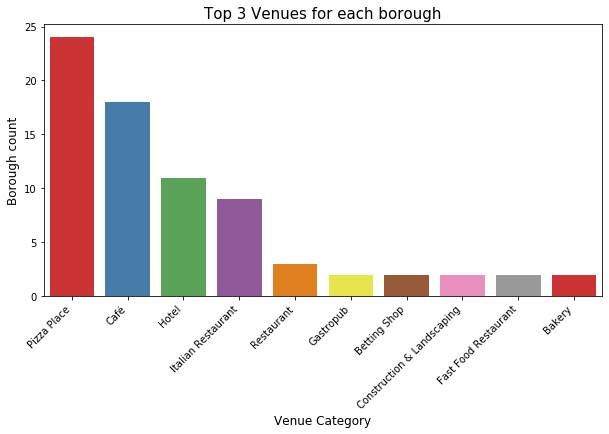

In [198]:
import seaborn as sns
import matplotlib.pyplot as plt

data_to_plot = top3_boroughs[['Venue Category']].groupby(['Venue Category']).size().reset_index(name = 'counts').sort_values('counts', ascending = False)

plt.figure(figsize=(10,5))

chart = sns.barplot(x='Venue Category', y = 'counts', data = data_to_plot.head(10),palette = 'Set1')

#remove graph borders 
plt.rc('axes.spines', **{'bottom':True, 'left':True, 'right':False, 'top':False})

plt.xticks(
    rotation=45, 
    horizontalalignment='right',
    fontweight='light',
    size=10  
)


plt.title('Top 3 Venues for each borough', size = 15)
plt.xlabel('Venue Category', size = 12)
plt.ylabel('Borough count', size = 12)



As we already suspected, Pizzeria are the most frequent venue in every top 3 of each borough.

Lets now find which are the venues near each pizzeria. We could find it in two way:
- iterate over every pizzeria and find which venue previously extracted are near
- use the EXPLORE function of Foursquare API

In [58]:
from geopy import distance 
def inside(center, venue, radius=500):
    d = (distance.distance(tuple(center),tuple(venue)).km)*1000
    return 1*(d < radius)
    

In [231]:
df_near = getNearbyVenues_v2(names=top['id'],
                                      latitudes=top['Venue Latitude'],
                                      longitudes=top['Venue Longitude'],
                                      radius = 500)

In [234]:
df_near.shape

(5245, 6)

In [235]:
df_near.head()

,Center,Venue,Venue ID,Venue Latitude,Venue Longitude,Venue Category
0,4c191cad834e2d7f50e42980,Pizzeria La Notizia,4c191cad834e2d7f50e42980,40.835749,14.209840,Pizza Place
1,4c191cad834e2d7f50e42980,pizzeria gaetano genovesi,55a6c55b498e4f5ac2760547,40.835365,14.211542,Pizza Place
2,4c191cad834e2d7f50e42980,Carrefour Market,4e58d7ce2271886714ea723e,40.837883,14.214211,Supermarket
3,4c191cad834e2d7f50e42980,Krugel,4e43932e1fc752e9103fad70,40.838380,14.214197,Sandwich Place
4,4c191cad834e2d7f50e42980,Pizzeria La Caraffa,4d58427136d1721eceabf4b1,40.838522,14.214109,Pizza Place


### Feature engineering

Lets now create a dataframe that counts venue category for each Pizzeria. We will perform the so-called One Hot Encoding.

In [238]:
df_near_pivot = df_near[['Center','Venue Category']].groupby(['Center','Venue Category']).size().reset_index().pivot(index='Center', columns = 'Venue Category')

In [242]:
df_near_pivot = pd.pivot_table(df_near[['Center','Venue Category','Venue ID']], index='Center', columns='Venue Category', aggfunc='count').fillna(0)
df_near_pivot.columns = df_near_pivot.columns.droplevel(0)

In [243]:
df_near_pivot.head()

Venue Category,Airport,Airport Terminal,Aquarium,Art Gallery,Art Museum,Asian Restaurant,Auto Garage,BBQ Joint,Bakery,Bar,Basketball Stadium,Bed & Breakfast,Beer Bar,Beer Store,Bistro,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Breakfast Spot,Buffet,Burger Joint,Cable Car,Cafeteria,Café,Campanian Restaurant,Candy Store,Castle,Cheese Shop,Chinese Restaurant,Church,Clothing Store,Cocktail Bar,Coffee Shop,College Cafeteria,Comic Shop,Concert Hall,Convenience Store,Cosmetics Shop,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Dive Bar,Donut Shop,Electronics Store,Fast Food Restaurant,Fish & Chips Shop,Fish Market,Food,Food & Drink Shop,Food Truck,Fountain,Fried Chicken Joint,Friterie,Frozen Yogurt Shop,Furniture / Home Store,Garden,Gastropub,German Restaurant,Gift Shop,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Historic Site,History Museum,Hostel,Hotel,Ice Cream Shop,Island,Italian Restaurant,Japanese Restaurant,Jazz Club,Juice Bar,Light Rail Station,Lighthouse,Lingerie Store,Lounge,Market,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Movie Theater,Multiplex,Museum,Music School,Music Venue,Nightclub,Noodle House,Opera House,Other Great Outdoors,Other Repair Shop,Outdoors & Recreation,Palace,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Pet Store,Pharmacy,Pizza Place,Platform,Plaza,Pool,Pub,Record Shop,Rental Car Location,Restaurant,Road,Sandwich Place,Scenic Lookout,Science Museum,Seafood Restaurant,Shopping Mall,Smoke Shop,Snack Place,Soccer Field,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Stables,Stadium,Steakhouse,Supermarket,Sushi Restaurant,Tapas Restaurant,Theater,Theme Park,Toy / Game Store,Trail,Train Station,Trattoria/Osteria,Travel Agency,Vegetarian / Vegan Restaurant,Waterfront,Wine Bar,Winery,Zoo
Center,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
4b3b7359f964a520057425e3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,10.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,16.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
4b519aa5f964a5208f5027e3,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,3.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0
4b7d8f92f964a520d3c62fe3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4b8ecf2cf964a5207f3833e3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,1.0,0.0,0.0,3.0,0.0

In [788]:
#df_near_pivot.to_csv('df_near_pivot.csv',index = False)

df_near_pivot = pd.read_csv('Data/df_near_pivot.csv')
df_near_pivot.index = top['id'].sort_values()

In [789]:
df_near_pivot.shape

(138, 147)

In [867]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

kmin = 2
kmax = 20

distortions=[]  # empty list for sum of squared error
sil = []

for k in range(kmin, kmax+1):
    kmeanModel = KMeans(n_clusters=k, random_state = 111).fit(df_near_pivot)
    labels = kmeanModel.labels_
    sil.append(silhouette_score(df_near_pivot, labels, metric = 'euclidean'))
    distortions.append(kmeanModel.inertia_)

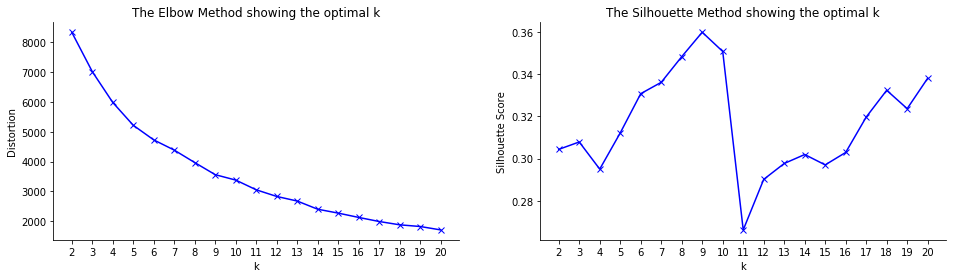

In [868]:
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(16,4))
ax1 = fig.add_subplot(1,2,1)
plt.plot(range(kmin, kmax+1), distortions, 'bx-')
plt.xlabel('k')
plt.xticks(range(kmin,kmax+1))
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')

ax1 = fig.add_subplot(1,2,2)

plt.plot(range(2, kmax+1), sil, 'bx-')
plt.xlabel('k')
plt.xticks(range(kmin,kmax+1))
plt.ylabel('Silhouette Score')
plt.title('The Silhouette Method showing the optimal k')
plt.show()


In [869]:
kclusters = 9

Lets fit the model with k = 6.

In [870]:
kmeanModel = KMeans(n_clusters=kclusters,random_state = 111).fit(X)
labels = kmeanModel.labels_


In [871]:
try:
    df_near_pivot.drop('Cluster Labels', axis=1, inplace=True)
except:
    pass
df_near_pivot.insert(0, 'Cluster Labels', labels)

In [872]:
top_clust = top.merge(df_near_pivot['Cluster Labels'].reset_index(), on ='id', how = 'left')

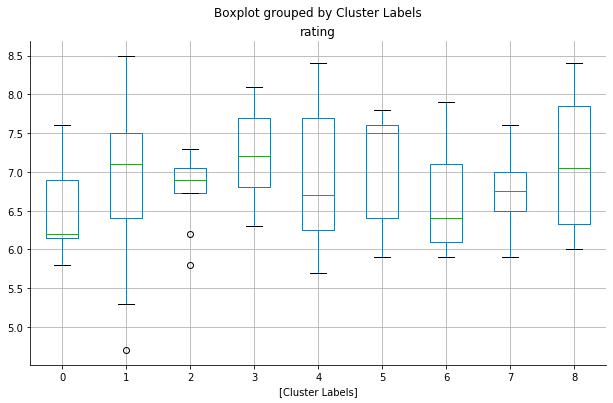

In [873]:
top_clust[['Cluster Labels','rating']].boxplot(by = ['Cluster Labels'], figsize=(10,6))
plt.show()

In [911]:
top_clust[['Cluster Labels','rating']].groupby('Cluster Labels').median().sort_values(by='rating',ascending=False)

,rating
Cluster Labels,
5,7.50
3,7.20
1,7.10
8,7.05
2,6.90
7,6.75
4,6.70
6,6.40
0,6.20


In [875]:
def map_legend_html(label, color, position = ['bottom','right'], position_cord = [20, 50], width = 100, height = 150, fontsize=13):
    strg = ''
    for label, color in enumerate(rainbow):
        strg = strg + '&nbsp; '+ str(label) + ' &nbsp; <i class="fa fa-circle fa-1x"\n style="color:'+color+'"></i><br>\n'
    
    legend_html = '''
    <div style="position: fixed;'''+position[0]+''':'''+str(position_cord[0])+'''px; '''+position[1]+''': '''+str(position_cord[1])+'''px;width: '''+str(width)+'''px; height:'''+str(height)+'''px; 
    border:3px solid grey; z-index:9999; font-size:'''+str(fontsize)+'''px;
    backgroud-color: white;
    ">&nbsp; Legend <br>'''+strg+'''
    </div>'''
    return (legend_html)

In [903]:
address = 'Napoli, IT'

location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=13)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
for rating, venue, lat, lon, poi, cluster in zip(top_clust['rating'],top_clust['Venue'],
                                                 top_clust['Venue Latitude'], top_clust['Venue Longitude'],
                                                 top_clust['Borough'], top_clust['Cluster Labels']):
    label = folium.Popup('({}) {}, {}, Cluster {}'.format(rating, venue, poi, cluster),parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=4,
        weight= 2,
        popup=label,
        color=rainbow[int(cluster)],
        fill=True,
        fill_color=rainbow[int(cluster)],
        fill_opacity=0.5).add_to(map_clusters)



html_legend = map_legend_html(x,rainbow,position = ['bottom','right'],position_cord = [20,50], height = 195)

map_clusters.get_root().html.add_child(folium.Element(html_legend))
map_clusters

display(map_clusters)

We have now built the model. Since we are looking for similar area to ones found, we are going to sample data from boroughs and use Foursquare API to get nearby venues.

In [549]:
finding_venue = []
num_of_samples = 500
for j, borough in enumerate(points_shape_map['QUART']):
    tmp = generate_random(num_of_samples,points_shape_map.loc[points_shape_map['QUART']==borough,'geometry'][j])
    finding_venue.append([(
        borough, 
        point.y,
        point.x) for point in tmp])
    finding_venue_all = pd.DataFrame([item for points in finding_venue for item in points], columns = ['Borough','Latitude','Longitude'])

In [550]:
finding_venue_all.shape

(15000, 3)

In [551]:
finding_venue_all.reset_index(inplace=True)
finding_venue_all.head()

,index,Borough,Latitude,Longitude
0,0,Chiaia,40.833693,14.240661
1,1,Chiaia,40.832933,14.221130
2,2,Chiaia,40.825694,14.216657
3,3,Chiaia,40.838042,14.225382
4,4,Chiaia,40.834958,14.217981


In [800]:
#finding_venue_all.to_csv('Data/finding_venue_all.csv', index=False)

In [877]:
try:
    del(finding_venue_all)
except:
    pass

finding_venue_all = pd.read_csv('Data/finding_venue_all.csv')


In [878]:
finding_venue_all.head()

,index,Borough,Latitude,Longitude
0,0,Chiaia,40.833693,14.240661
1,1,Chiaia,40.832933,14.221130
2,2,Chiaia,40.825694,14.216657
3,3,Chiaia,40.838042,14.225382
4,4,Chiaia,40.834958,14.217981


We need to modify the getNearbyVenues function in oder to also get where the exploration has been done.

In [562]:
def getNearbyVenues_v2(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        #print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        try:
            results = requests.get(url).json()["response"]['groups'][0]['items']
        
            # return only relevant information for each nearby venue
            venues_list.append([(
                name,
                v['venue']['name'],
                v['venue']['id'],
                v['venue']['location']['lat'], 
                v['venue']['location']['lng'],
                v['venue']['categories'][0]['name']) for v in results])
        except:
            pass

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = [
                  'Center',  
                  'Venue', 
                  'Venue ID',
                  'Venue Latitude', 
                  'Venue Longitude',
                  'Venue Category']
    
    return(nearby_venues)

In [563]:
exploring_venues = getNearbyVenues_v2(names=finding_venue_all['index'],
                                      latitudes=finding_venue_all['Latitude'],
                                      longitudes=finding_venue_all['Longitude'],
                                      radius = 500)

In [564]:
#exploring_venues.to_csv('Data/exploring_venues.csv', index=False)

In [879]:
try:
    del(exploring_venues)
except:
    pass

exploring_venues = pd.read_csv('Data/exploring_venues.csv')

In [880]:
exploring_venues.head()

,Center,Venue,Venue ID,Venue Latitude,Venue Longitude,Venue Category
0,0,Enoteca Belledonne,4bd712e5637ba5931935f970,40.835179,14.239379,Wine Bar
1,0,L'Antiquario,567b03f0498e836ef543fa10,40.833019,14.242272,Speakeasy
2,0,Piazza dei Martiri,4c29ea72fe6e2d7f007c553c,40.834333,14.241932,Plaza
3,0,Via Francesco Caracciolo,4b92fff7f964a520b72d34e3,40.831665,14.240390,Road
4,0,Gourmeet,54d8a12e498e258e7dca40c2,40.834760,14.241183,Bistro


Lets turn in the pivot form usable for the prediction. We will so aggregate over Center, with Venue Category on columns and count as value.

In [881]:
exploring_venues_pivot = pd.pivot_table(exploring_venues[['Center','Venue Category','Venue ID']], index='Center', columns='Venue Category', aggfunc='count').fillna(0)
exploring_venues_pivot.columns = exploring_venues_pivot.columns.droplevel(0)

In [882]:
exploring_venues_pivot.head()

Venue Category,Accessories Store,Advertising Agency,Airport,Airport Gate,Airport Service,Airport Terminal,Aquarium,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,Auto Dealership,Auto Garage,Automotive Shop,BBQ Joint,Baby Store,Bakery,Bar,Baseball Field,Basketball Court,Basketball Stadium,Bathing Area,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Betting Shop,Bistro,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Breakfast Spot,Brewery,Bridal Shop,Buffet,Building,Burger Joint,Bus Station,Business Service,Butcher,Cable Car,Cafeteria,Café,Camera Store,Campanian Restaurant,Campground,Candy Store,Carpet Store,Casino,Castle,Cemetery,Cheese Shop,Chinese Restaurant,Church,Clothing Store,Cocktail Bar,Coffee Shop,College Cafeteria,Comedy Club,Comfort Food Restaurant,Comic Shop,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Cruise,Cupcake Shop,Dance Studio,Deli / Bodega,Dentist's Office,Department Store,Design Studio,Dessert Shop,Diner,Dive Bar,Donut Shop,Electronics Store,Event Service,Event Space,Farm,Farmers Market,Fast Food Restaurant,Fire Station,Fish & Chips Shop,Fish Market,Fishing Store,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Truck,Fountain,Fried Chicken Joint,Friterie,Frozen Yogurt Shop,Funeral Home,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,German Restaurant,Gift Shop,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gym Pool,Harbor / Marina,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Home Service,Hostel,Hotel,Hotel Bar,IT Services,Ice Cream Shop,Indie Movie Theater,Indoor Play Area,Intersection,Island,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Kids Store,Light Rail Station,Lighthouse,Lingerie Store,Locksmith,Lounge,Market,Martial Arts Dojo,Mattress Store,Medical Supply Store,Mediterranean Restaurant,Memorial Site,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Motorcycle Shop,Mountain,Movie Theater,Multiplex,Museum,Music School,Music Venue,National Park,Nightclub,Noodle House,Opera House,Optical Shop,Other Great Outdoors,Other Repair Shop,Outdoors & Recreation,Palace,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Perfume Shop,Pet Service,Pet Store,Pharmacy,Pier,Pizza Place,Platform,Playground,Plaza,Pool,Pool Hall,Post Office,Print Shop,Pub,Record Shop,Rental Car Location,Rental Service,Resort,Rest Area,Restaurant,Road,Roof Deck,Sandwich Place,Scenic Lookout,School,Science Museum,Seafood Restaurant,Shipping Store,Shoe Repair,Shoe Store,Shop & Service,Shopping Mall,Smoke Shop,Snack Place,Soccer Field,Soccer Stadium,Spa,Spanish Restaurant,Speakeasy,Sporting Goods Shop,Sports Club,Stables,Stadium,Steakhouse,Supermarket,Sushi Restaurant,Tapas Restaurant,Tennis Court,Tennis Stadium,Theater,Theme Park,Thrift / Vintage Store,Toll Booth,Toy / Game Store,Track,Trail,Train Station,Tram Station,Transportation Service,Trattoria/Osteria,Travel Agency,Vacation Rental,Vegetarian / Vegan Restaurant,Vietnamese Restaurant,Warehouse Store,Waterfront,Wine Bar,Wine Shop,Winery,Women's Store,Yoga Studio,Zoo
Center,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,3.0,2.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

In [883]:
kmeanModel.predict(exploring_venues_pivot)

ValueError: Incorrect number of features. Got 250 features, expected 147

It seems that in features from news observation differ from ones used in the model training. We are now going to select common one, and set to 0 the ones that are not present.

In [884]:
df_near_pivot.shape

(138, 148)

In [885]:
common_features = list(set(exploring_venues_pivot.columns.to_list()).intersection(df_near_pivot.columns.to_list()))
print('The two df have {} in common'.format(len(common_features)))

The two df have 147 in common


In [886]:
features_in_model = list(set(df_near_pivot.columns.to_list()) - set(exploring_venues_pivot.columns.to_list()))
print('{}'.format(len(features_in_model)))

1


Lets also remove Cluster Labels that we have previously added as result of agorithm.

In [887]:
features_in_model.remove('Cluster Labels')

In [888]:
exploring_venues_pivot=exploring_venues_pivot[common_features].assign(**dict.fromkeys(features_in_model, 0))

In [889]:
exploring_venues_pivot.shape

(14319, 147)

In [890]:
pred = kmeanModel.predict(exploring_venues_pivot)

In [891]:
exploring_venues_pivot.head().shape

(5, 147)

In [892]:
exploring_venues_pivot['Cluster Labels'] = pred

In [893]:
exploring_venues_pivot.head()

Venue Category,Ice Cream Shop,Italian Restaurant,Snack Place,Men's Store,Pub,Speakeasy,Platform,Campanian Restaurant,Boat or Ferry,Metro Station,Cupcake Shop,Basketball Stadium,Theme Park,Beer Store,Greek Restaurant,Winery,Gym / Fitness Center,Bed & Breakfast,Aquarium,Lighthouse,Gym,Island,Trail,Other Repair Shop,Historic Site,Tapas Restaurant,Art Gallery,Cafeteria,Music School,Church,Market,Clothing Store,Gastropub,Juice Bar,Zoo,Cheese Shop,Nightclub,Fish & Chips Shop,Pet Store,Frozen Yogurt Shop,Toy / Game Store,Rental Car Location,Airport,Road,Soccer Field,Chinese Restaurant,Bistro,Candy Store,Airport Terminal,Sushi Restaurant,Fountain,Japanese Restaurant,Sporting Goods Shop,Sandwich Place,Bowling Alley,Bakery,Dessert Shop,Castle,Bar,Dance Studio,Harbor / Marina,Stadium,Garden,Perfume Shop,Fish Market,Comic Shop,Asian Restaurant,Mediterranean Restaurant,Music Venue,Diner,Opera House,Fast Food Restaurant,Breakfast Spot,Pedestrian Plaza,Cable Car,Spanish Restaurant,Fried Chicken Joint,Burger Joint,Palace,Seafood Restaurant,BBQ Joint,Jazz Club,Lingerie Store,Hotel,Furniture / Home Store,Record Shop,Trattoria/Osteria,History Museum,Pastry Shop,Supermarket,Train Station,Noodle House,Dive Bar,Museum,Cosmetics Shop,Convenience Store,Scenic Lookout,Auto Garage,Pool,Paper / Office Supplies Store,Donut Shop,Waterfront,Friterie,Food & Drink Shop,Multiplex,Plaza,Science Museum,Cocktail Bar,Middle Eastern Restaurant,Park,Stables,Travel Agency,Beer Bar,Food,Boutique,Lounge,Restaurant,Mexican Restaurant,Grocery Store,Smoke Shop,Pharmacy,Wine Bar,Art Museum,German Restaurant,College Cafeteria,Concert Hall,Outdoors & Recreation,Bookstore,Shopping Mall,Gift Shop,Other Great Outdoors,Department Store,Pizza Place,Café,Food Truck,Electronics Store,Coffee Shop,Vegetarian / Vegan Restaurant,Buffet,Hostel,Deli / Bodega,Performing Arts Venue,Steakhouse,Movie Theater,Theater,Light Rail Station,Gourmet Shop,Cluster Labels
Center,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,5.0,6.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,2.0,0.0,0.0,3.0,0.0,3.0,0.0,1.0,0.0,1.0,3.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,3.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,3.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,3.0,0.0,4.0,0.0,1.0,0.0,0.0,1.0,0.0,3.0,1.0,2.0,0.0,0.0,0.0,0.0,3.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,8.0,5.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,2
1,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1
2,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
3,0.0,2.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [894]:
exploring_venues_pivot['Cluster Labels'].value_counts()

1    11721
5      983
2      780
6      378
7      221
8      136
0       69
4       31
Name: Cluster Labels, dtype: int64

In [895]:
expl_venues_merge = finding_venue_all.merge(exploring_venues_pivot['Cluster Labels'].reset_index().rename(columns = {'Center':'index'}), on ='index', how = 'left')

In [896]:
expl_venues_merge.head()

,index,Borough,Latitude,Longitude,Cluster Labels
0,0,Chiaia,40.833693,14.240661,2.0
1,1,Chiaia,40.832933,14.221130,1.0
2,2,Chiaia,40.825694,14.216657,1.0
3,3,Chiaia,40.838042,14.225382,1.0
4,4,Chiaia,40.834958,14.217981,1.0


In [897]:
sum(expl_venues_merge['Cluster Labels'].isna())

681

In [822]:
df_to_plot = expl_venues_merge[expl_venues_merge['Cluster Labels'].notnull()]

In [898]:
df_to_plot.head()

,index,Borough,Latitude,Longitude,Cluster Labels
0,0,Chiaia,40.833693,14.240661,6.0
1,1,Chiaia,40.832933,14.221130,1.0
2,2,Chiaia,40.825694,14.216657,1.0
3,3,Chiaia,40.838042,14.225382,1.0
4,4,Chiaia,40.834958,14.217981,1.0


In [914]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]


# add markers to the map - finding venue
for venue, lat, lon, cluster in zip(df_to_plot['index'],df_to_plot['Latitude'], df_to_plot['Longitude'], df_to_plot['Cluster Labels']):
    label = folium.Popup('{}, Cluster {}'.format(venue, cluster),parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=0.1,
        popup=label,
        color=rainbow[int(cluster)-1],
        weight = 1,
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.1).add_to(map_clusters)

    
html_legend = map_legend_html(x,rainbow,position = ['bottom','left'],position_cord = [20,50], height = 195)
map_clusters.get_root().html.add_child(folium.Element(html_legend))

    
display(map_clusters)